### Importing relevant libraries

In [2]:
import numpy as np
import pandas as pd
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import train_test_split, GridSearchCV
from sklearn.tree import DecisionTreeClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.svm import SVC
from sklearn.metrics import accuracy_score, f1_score, confusion_matrix, auc, roc_curve, classification_report
from sklearn.preprocessing import StandardScaler
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
from sklearn.preprocessing import LabelEncoder
from sklearn.ensemble import RandomForestClassifier

### Data Ingestion 

In [3]:
dt_train = pd.read_csv('ecommerce_train.csv')
test = pd.read_csv('ecommerce_test.csv')

In [3]:
dt_train.head()

,session_id,administrative,administrative_duration,informational,informational_duration,productrelated,productrelated_duration,bouncerates,exitrates,pagevalues,specialday,month,operatingsystems,browser,region,traffictype,visitortype,weekend,revenue
0,139957,2,47.500000,0,0.0,19,1203.480714,0.000000,0.027421,6.748509,0.0,Nov,2,2,3,2,Returning_Visitor,False,0
1,496587,0,0.000000,0,0.0,7,152.000000,0.000000,0.033333,0.000000,0.0,Dec,3,2,6,3,Returning_Visitor,False,0
2,440268,7,206.500000,1,389.9,95,4415.889952,0.000133,0.033750,2.676062,0.0,Nov,2,2,1,20,Returning_Visitor,False,0
3,294672,1,18.258571,0,0.0,103,8305.048706,0.004871,0.034746,6.824908,0.0,Nov,2,2,1,2,Returning_Visitor,True,1
4,497475,0,0.000000,0,0.0,42,1305.108333,0.016068,0.039742,0.000000,0.0,Dec,3,2,5,2,Returning_Visitor,False,0


In [4]:
test.head(2)

,session_id,administrative,administrative_duration,informational,informational_duration,productrelated,productrelated_duration,bouncerates,exitrates,pagevalues,specialday,month,operatingsystems,browser,region,traffictype,visitortype,weekend
0,283149,0,0.0,0,0.0,10,388.0,0.000000,0.014286,0.0,0.0,Nov,1,2,8,2,New_Visitor,False
1,253020,0,0.0,0,0.0,17,142.4,0.017707,0.044623,0.0,0.0,Nov,1,2,3,8,New_Visitor,False


In [5]:
dt_train.shape

(40000, 19)

In [6]:
test.shape

(10000, 18)

In [7]:
dt_train.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 40000 entries, 0 to 39999
Data columns (total 19 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   session_id               40000 non-null  int64  
 1   administrative           40000 non-null  int64  
 2   administrative_duration  40000 non-null  float64
 3   informational            40000 non-null  int64  
 4   informational_duration   40000 non-null  float64
 5   productrelated           40000 non-null  int64  
 6   productrelated_duration  40000 non-null  float64
 7   bouncerates              40000 non-null  float64
 8   exitrates                40000 non-null  float64
 9   pagevalues               40000 non-null  float64
 10  specialday               40000 non-null  float64
 11  month                    40000 non-null  object 
 12  operatingsystems         40000 non-null  object 
 13  browser                  40000 non-null  object 
 14  region                

In [8]:
dt_train.isna().sum()

session_id                 0
administrative             0
administrative_duration    0
informational              0
informational_duration     0
productrelated             0
productrelated_duration    0
bouncerates                0
exitrates                  0
pagevalues                 0
specialday                 0
month                      0
operatingsystems           0
browser                    0
region                     0
traffictype                0
visitortype                0
weekend                    0
revenue                    0
dtype: int64

In [9]:
dt_train.describe()

,session_id,administrative,administrative_duration,informational,informational_duration,productrelated,productrelated_duration,bouncerates,exitrates,pagevalues,specialday,region,revenue
count,40000.000000,40000.000000,40000.000000,40000.000000,40000.000000,40000.000000,40000.000000,40000.000000,40000.000000,40000.000000,40000.000000,40000.000000,40000.000000
mean,311469.372075,2.544150,89.794383,0.555225,40.977236,34.026975,1148.105672,0.021969,0.042307,6.494963,0.063553,3.241975,0.158275
std,108498.432497,3.667252,182.964645,1.332627,153.114387,46.798102,1666.181462,0.048533,0.048633,17.710646,0.199463,2.423586,0.365003
min,123460.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000
25%,217950.000000,0.000000,0.000000,0.000000,0.000000,7.000000,183.883333,0.000000,0.013389,0.000000,0.000000,1.000000,0.000000
50%,311194.500000,1.000000,11.200000,0.000000,0.000000,19.000000,560.075000,0.003304,0.025000,0.000000,0.000000,3.000000,0.000000
75%,404680.500000,4.000000,110.154167,0.000000,0.000000,41.000000,1420.536667,0.016667,0.050000,0.000000,0.000000,4.000000,0.000000
max,499982.000000,22.000000,1946.000000,11.000000,1767.666667,440.000000,18504.126210,0.200000,0.200000,226.677702,1.000000,9.000000,1.000000


In [10]:
dt_train.describe(include='O')

,month,operatingsystems,browser,traffictype,visitortype
count,40000,40000,40000,40000,40000
unique,10,6,11,15,3
top,May,2,2,2,Returning_Visitor
freq,11048,21638,25540,12545,34496


In [11]:
dt_train.select_dtypes("object").nunique()

month               10
operatingsystems     6
browser             11
traffictype         15
visitortype          3
dtype: int64

In [12]:
categorical_features = dt_train.select_dtypes("object").columns
len(categorical_features)

5

In [13]:
for col in categorical_features:
    print(dt_train[col].value_counts())

May     11048
Nov      9625
Mar      6086
Dec      5621
Oct      1661
Sep      1503
Aug      1474
Jul      1429
June      857
Feb       696
Name: month, dtype: int64
2    21638
3     8439
1     8104
4     1498
8      236
*       85
Name: operatingsystems, dtype: int64
2     25540
1      7557
4      2783
5      1723
6       616
10      564
3       412
8       392
13      198
7       165
*        50
Name: browser, dtype: int64
2     12545
1      7323
3      6753
4      3622
13     2860
10     1510
6      1457
8      1270
5       874
11      728
20      563
15      147
9       124
*       120
7       104
Name: traffictype, dtype: int64
Returning_Visitor    34496
New_Visitor           5224
Other                  280
Name: visitortype, dtype: int64


### Checking for target column distribution

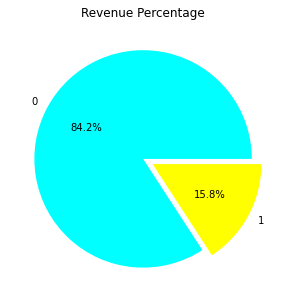

In [15]:
cnt = dt_train['revenue'].value_counts()
fig,ax = plt.subplots(figsize=(5,5))
ax.pie(x=cnt.values,labels=cnt.index, autopct='%1.1f%%',colors=['cyan','yellow'],explode=(0,0.1))
ax.set_title('Revenue Percentage');

### As we can see from above countplot, the dataset is *highly imbalanced* 

### EDA

In [16]:
rev_month = dt_train['month'].value_counts()
months = pd.DataFrame(data=rev_month.index, columns=["month"])
months['values'] = rev_month.values

In [17]:
fig = px.pie(months, values='values', names='month', color_discrete_sequence=px.colors.sequential.RdBu, title= "Counts of months")
fig.show()

In [18]:
def histogram(data,path,color,title,xaxis,yaxis):
    fig = px.histogram(data, x=path,color=color)
    fig.update_layout(
        title_text=title,
        xaxis_title_text=xaxis, 
        yaxis_title_text=yaxis, 
        bargap=0.2, 
        bargroupgap=0.1
    )
    fig.show()

In [19]:
calendar_months = ['Jan', 'Feb', 'Mar', 'Apr','May','June', 'Jul', 'Aug','Sep', 'Oct', 'Nov', 'Dec']

In [20]:
def histogram_1(data,path,color,title,xaxis,yaxis):
    fig = px.histogram(data, x=path,color=color,category_orders=dict(month=calendar_months))
    fig.update_layout(
        title_text=title,
        xaxis_title_text=xaxis, 
        yaxis_title_text=yaxis, 
        bargap=0.2, 
        bargroupgap=0.1
    )
    fig.show()

In [21]:
histogram_1(dt_train,"month","revenue",'Monthly revenue','month','Count')

### `Nov, May, Dec and March generating more revenues than other months`

In [22]:
rev_region = dt_train['region'].value_counts()
region = pd.DataFrame(data=rev_region.index, columns=["region"])
region['values'] = rev_region.values

In [23]:
fig = px.pie(region, values='values', names='region', color_discrete_sequence=px.colors.sequential.RdBu, title= "Counts of regions")
fig.show()

In [24]:
histogram(dt_train,"region","revenue",'Region wise revenue','region','Count')

### `Region 1 has highest revenue`

In [25]:
rev_os = dt_train['operatingsystems'].value_counts()
os = pd.DataFrame(data=rev_os.index, columns=["operatingsystems"])
os['values'] = rev_os.values

In [26]:
fig = px.pie(os, values='values', names='operatingsystems', color_discrete_sequence=px.colors.sequential.RdBu, title="Counts of operating systems")
fig.show()

In [27]:
histogram(dt_train,"operatingsystems","revenue",'Revenue on operatingsystems','operatingsystems','Count')

### Operating system 2 has the maximum revenue

In [28]:
rev_browser = dt_train['browser'].value_counts()
browser = pd.DataFrame(data=rev_browser.index, columns=["browser"])
browser['values'] = rev_browser.values

In [29]:
fig = px.pie(browser, values='values', names='browser', color_discrete_sequence=px.colors.sequential.RdBu, title= "Counts of Browser")
fig.show()

In [30]:
histogram(dt_train,"browser","revenue",'Revenue on browser','browser','Count')

### Browser 2 has maximum revenue

In [31]:
rev_traffictype = dt_train['traffictype'].value_counts()
traffictype = pd.DataFrame(data=rev_traffictype.index, columns=["traffictype"])
traffictype['values'] = rev_traffictype.values

In [32]:
fig = px.pie(traffictype, values='values', names='traffictype', color_discrete_sequence=px.colors.sequential.RdBu,title="Counts of traffictype")
fig.show()

In [33]:
histogram(dt_train,"traffictype","revenue",'Revenue on traffictype','traffictype','Count')

### Traffictype 2 has highest revenue

In [34]:
rev_visitortype = dt_train['visitortype'].value_counts()
visitortype = pd.DataFrame(data=rev_visitortype.index, columns=["visitortype"])
visitortype['values'] = rev_visitortype.values

In [35]:
fig = px.pie(visitortype, values='values', names='visitortype', color_discrete_sequence=px.colors.sequential.RdBu, title= "Counts of visitors")
fig.show()

In [36]:
histogram(dt_train,"visitortype","revenue",'Revenue on visitortype','visitortype','Count')

### Returning_Visitor has maximum revenue

In [37]:
histogram(dt_train,"weekend","revenue",'Revenue on weekends','weekend','Count')

### Revenue on Weekend is maximum

In [4]:
px.scatter(dt_train, x='administrative', y='bouncerates',color='revenue')

In [5]:
px.scatter(dt_train, x='administrative', y='exitrates',color='revenue')

In [40]:
px.scatter(dt_train, x='administrative', y='pagevalues',color='revenue')

In [6]:
px.scatter(dt_train, x='informational', y='bouncerates',color='revenue')

In [7]:
px.scatter(dt_train, x='informational', y='exitrates',color='revenue')

In [8]:
px.scatter(dt_train, x='informational', y='pagevalues',color='revenue')

In [9]:
px.scatter(dt_train, x='productrelated', y='bouncerates',color='revenue')

In [10]:
px.scatter(dt_train, x='productrelated', y='exitrates',color='revenue')

In [46]:
px.scatter(dt_train, x='productrelated', y='pagevalues',color='revenue')

## Observation
 * when exit rate/bouncerate increases, the probability of revenue becoming '0' is very hich and when pagevalue increases the probability of revenue becoming '1' is high. 

In [11]:
fig = px.scatter(dt_train, 
                 x = 'productrelated' , 
                 y = 'productrelated_duration', 
                 color='revenue')
fig.show()

### Product categories from 0 to 200 are most viewed 

### Outliers Detection

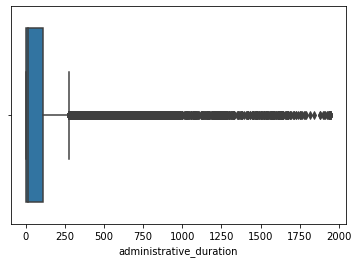

In [55]:
sns.boxplot(x='administrative_duration',data=dt_train);

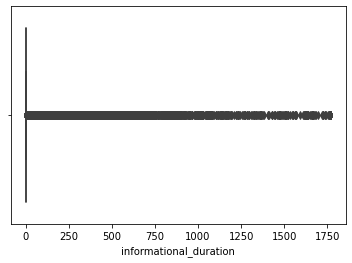

In [56]:
sns.boxplot(x='informational_duration',data=dt_train);

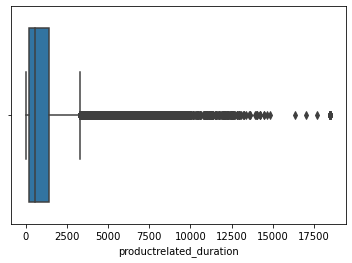

In [57]:
sns.boxplot(x='productrelated_duration',data=dt_train);

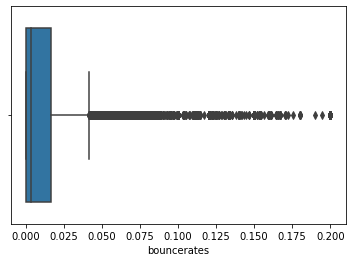

In [58]:
sns.boxplot(x='bouncerates',data=dt_train);

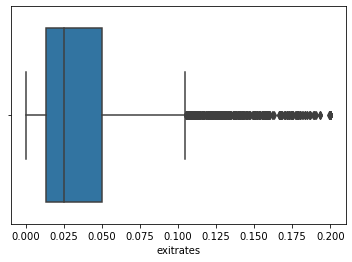

In [59]:
sns.boxplot(x='exitrates',data= dt_train);

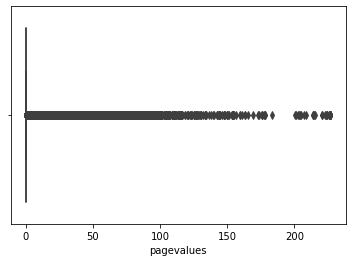

In [60]:
sns.boxplot(x='pagevalues',data=dt_train);

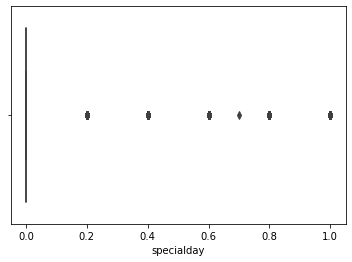

In [61]:
sns.boxplot(x='specialday',data=dt_train);

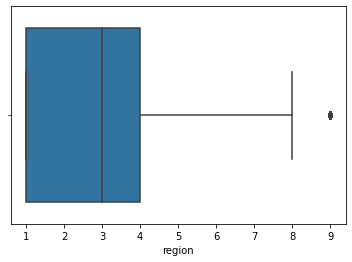

In [62]:
sns.boxplot(x='region',data= dt_train);

## Observation
* It seems like this data set resembles real time data, it has time as feature; in such a case a customer can spend as long time as they wish and that is considered normal. Hence it is not suitable to consider these extreme values as outliers. Hence we do not remove them.

### Correlation Analysis

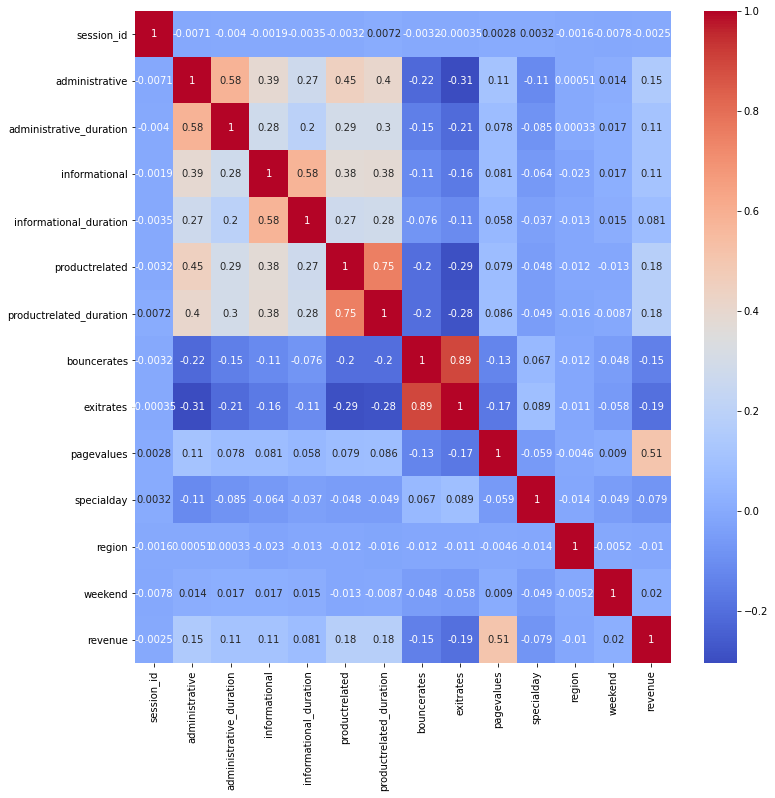

In [63]:
plt.figure(figsize=(12,12))
sns.heatmap(dt_train.corr(),annot=True,cmap='coolwarm');

In [64]:
session_ids_for_test = test.session_id

### In the following we are dropping the session id and keep only one of  the highly correlated columns by looking at the heatmap. What we find is that these columns do not impact the accuracy score. The score does not change either with or without keeping the columns in the dataset.

In [65]:
dt_train.drop(["session_id","productrelated_duration","exitrates","administrative_duration","informational_duration"],axis=1,inplace=True)

In [66]:
test.drop(["session_id","productrelated_duration","exitrates","administrative_duration","informational_duration"],axis=1,inplace=True)

In [67]:
dt_train['revenue'].value_counts()

0    33669
1     6331
Name: revenue, dtype: int64

In [68]:
X = dt_train.drop('revenue', axis = 1)
y = dt_train.revenue

In [69]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

In [70]:
for col in categorical_features:
    le_model = LabelEncoder()
    X_train[col] = le_model.fit_transform(X_train[col])
    X_test[col] = le_model.transform(X_test[col])
    test[col] = le_model.transform(test[col])

In [71]:
scaled_model = StandardScaler()
X_train = scaled_model.fit_transform(X_train)
X_test = scaled_model.transform(X_test)
test = scaled_model.transform(test)

### Support Vector Classifier 

In [72]:
from sklearn.svm import SVC

In [73]:
svc = SVC()

In [74]:
svc.fit(X_train, y_train)

SVC()

In [75]:
print(classification_report(y_train, svc.predict(X_train)))

              precision    recall  f1-score   support

           0       0.92      0.97      0.94     26915
           1       0.75      0.54      0.63      5085

    accuracy                           0.90     32000
   macro avg       0.83      0.75      0.78     32000
weighted avg       0.89      0.90      0.89     32000



In [76]:
print(classification_report(y_test,svc.predict(X_test)))

              precision    recall  f1-score   support

           0       0.92      0.96      0.94      6754
           1       0.72      0.52      0.60      1246

    accuracy                           0.89      8000
   macro avg       0.82      0.74      0.77      8000
weighted avg       0.89      0.89      0.89      8000



### Visualising confusion matrix 

In [77]:
from scikitplot.metrics import plot_confusion_matrix

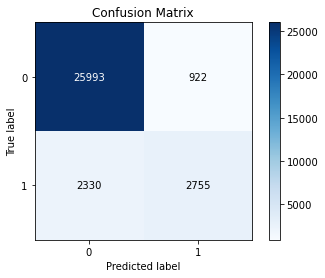

In [78]:
plot_confusion_matrix(y_train, svc.predict(X_train));

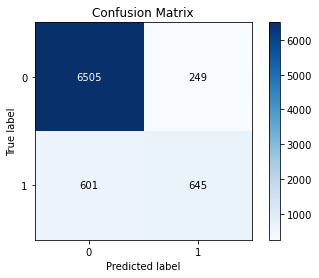

In [79]:
plot_confusion_matrix(y_test, svc.predict(X_test));

### Decision tree with hyperparameter tuning and crossvalidation

In [80]:
dtc= DecisionTreeClassifier()

In [81]:
params_dtc = {'max_depth':list(range(2,20))} # specifying the range for max_depths to create multiple trees

In [82]:
gs_dtc = GridSearchCV(estimator=dtc, param_grid=params_dtc, 
                      scoring='f1', cv=5).fit(X_train, y_train)
##### Manual
gs_dtc.best_params_, gs_dtc.best_score_

({'max_depth': 7}, 0.6593116445509427)

In [83]:
print(classification_report(y_train, gs_dtc.best_estimator_.predict(X_train)))

              precision    recall  f1-score   support

           0       0.93      0.96      0.94     26915
           1       0.74      0.62      0.67      5085

    accuracy                           0.90     32000
   macro avg       0.83      0.79      0.81     32000
weighted avg       0.90      0.90      0.90     32000



In [84]:
print(classification_report(y_test,
                            gs_dtc.best_estimator_.predict(X_test)))

              precision    recall  f1-score   support

           0       0.93      0.95      0.94      6754
           1       0.71      0.62      0.66      1246

    accuracy                           0.90      8000
   macro avg       0.82      0.79      0.80      8000
weighted avg       0.90      0.90      0.90      8000



### Visualising confusion matrix 

In [85]:
from scikitplot.metrics import plot_confusion_matrix

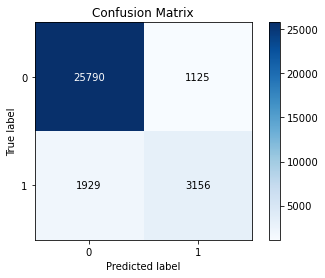

In [86]:
plot_confusion_matrix(y_train, gs_dtc.best_estimator_.predict(X_train));

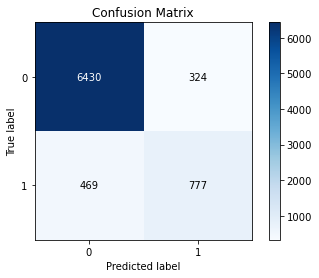

In [87]:
plot_confusion_matrix(y_test, gs_dtc.best_estimator_.predict(X_test));

### Visualising ROC_AUC curve

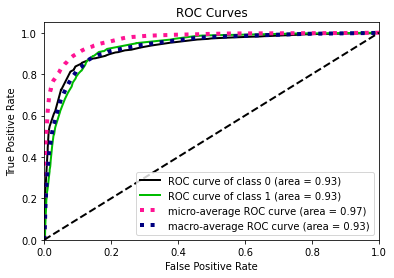

In [88]:
from scikitplot.metrics import plot_roc
y_pred_test = gs_dtc.best_estimator_.predict_proba(X_test)
plot_roc(y_test,y_pred_test);

### Visualising the fitted Decision tree classifier

In [89]:
from sklearn.tree import plot_tree

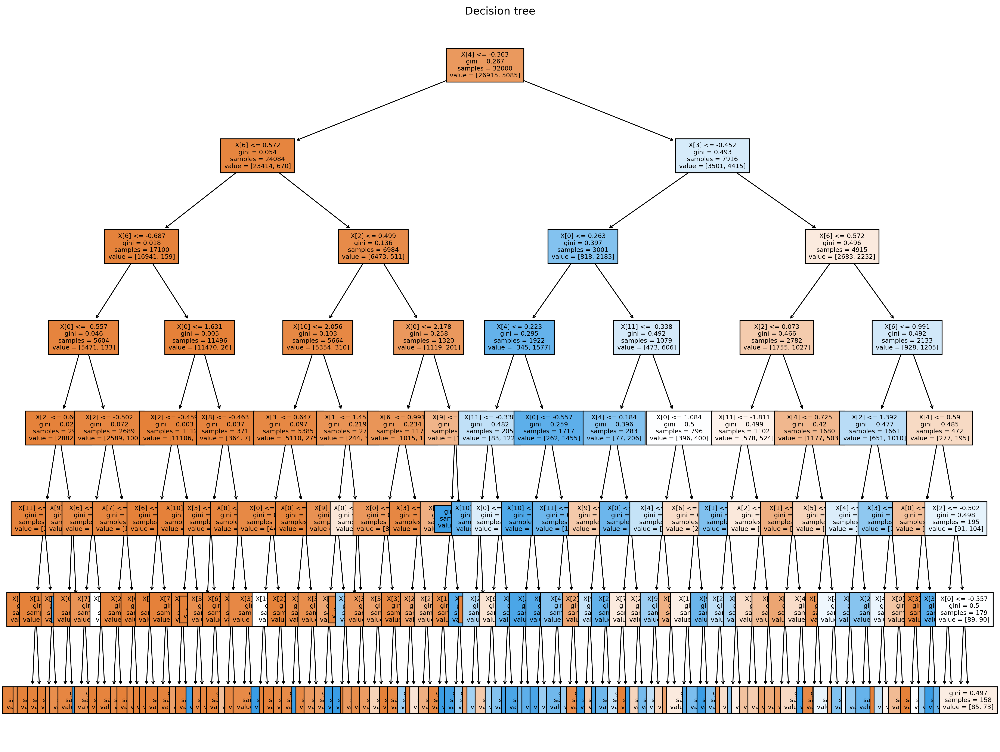

In [90]:
_, ax = plt.subplots(nrows=1, ncols=1, figsize=(19,15), dpi = 300) # Resize figure
plot_tree(gs_dtc.best_estimator_, filled=True, ax=ax, fontsize=7)
ax.set_title("Decision tree")
plt.show()

### Random Forest with hyperparameter tuning with crossvalidation

In [91]:
rfc= RandomForestClassifier()

In [92]:
params_rfc = {'max_depth':list(range(2,20)),'n_estimators':[10,25,50,100,200,500] } # specifying the range for max_depths to create multiple trees

In [93]:
gs_rfc = GridSearchCV(estimator=rfc, param_grid=params_rfc, scoring='f1', cv=5).fit(X_train, y_train)
##### Manual
gs_rfc.best_params_, gs_rfc.best_score_

({'max_depth': 12, 'n_estimators': 500}, 0.669963012788441)

In [94]:
print(classification_report(y_train, gs_rfc.best_estimator_.predict(X_train)))

              precision    recall  f1-score   support

           0       0.95      0.98      0.97     26915
           1       0.86      0.76      0.81      5085

    accuracy                           0.94     32000
   macro avg       0.91      0.87      0.89     32000
weighted avg       0.94      0.94      0.94     32000



### Visualising confusion matrix

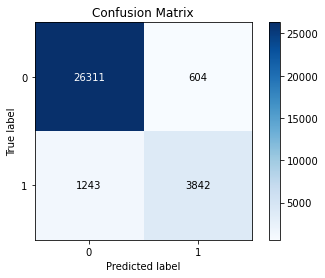

In [95]:
plot_confusion_matrix(y_train, gs_rfc.best_estimator_.predict(X_train));

In [96]:
print(classification_report(y_test, gs_rfc.best_estimator_.predict(X_test)))

              precision    recall  f1-score   support

           0       0.94      0.95      0.95      6754
           1       0.72      0.65      0.69      1246

    accuracy                           0.91      8000
   macro avg       0.83      0.80      0.82      8000
weighted avg       0.90      0.91      0.91      8000



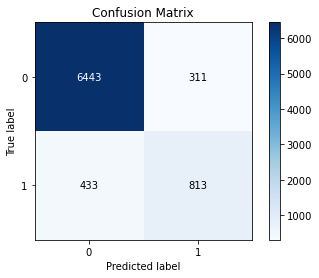

In [97]:
plot_confusion_matrix(y_test, gs_rfc.best_estimator_.predict(X_test));

### Visualising ROC_AUC curve

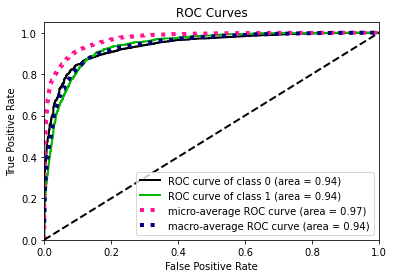

In [98]:
from scikitplot.metrics import plot_roc
y_pred_test = gs_rfc.best_estimator_.predict_proba(X_test)
plot_roc(y_test,y_pred_test);

### Classifying real test data with the fitted model

In [99]:
y_pred = gs_rfc.best_estimator_.predict(test)

# Dataframe example
df = pd.DataFrame({'session_id':session_ids_for_test,'revenue':y_pred.ravel()})

# Save dataframe as csv file in the current folder
df.to_csv('hackathon_sunday_2.csv', index = False, encoding='utf-8') # False: not include index
df

,session_id,revenue
0,283149,0
1,253020,0
2,348435,0
3,299763,0
4,195120,0
...,...,...
9995,278347,1
9996,498240,0
9997,296710,0
9998,226309,0
